In [1]:
#MASTER

In [264]:
#import all necessary libraries
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
import datetime as dt
from pandas_profiling import ProfileReport
from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans
import matplotlib.cm as cm

In [265]:
######################################################################### download
#load the csv file and save it into the dataframe donors
mypath=os.path.join("..","Project","donors.csv")
donors=pd.read_csv(os.path.join(mypath),index_col = 0)

C:\Users\betty\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3071: DtypeWarning: Columns (9,412) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [266]:
#top 5 rows of dataset for visualization
donors.head()

,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,...,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
0,2009-01-01,GRI,0,IL,61081,,,1957-12-01,0,,...,7.741935,95515,0,L,4,E,X,X,X,C
1,2014-01-01,BOA,1,CA,91326,,,1972-02-01,0,,...,15.666667,148535,0,L,2,G,X,X,X,A
2,2010-01-01,AMH,1,NC,27017,,,NaN,0,,...,7.481481,15078,1,L,4,E,X,X,X,C
3,2007-01-01,BRY,0,CA,95953,,,1948-01-01,0,,...,6.812500,172556,1,L,4,E,X,X,X,C
4,2006-01-01,,0,FL,33176,,,1940-01-01,0,X,...,6.864865,7112,1,L,2,F,X,X,X,A


In [267]:
# check id unique
donors['CONTROLN'].unique().size

95412

In [268]:
donors.set_index('CONTROLN',drop=True,inplace=True)

In [269]:
#shape of dataset so number of rows and columns
donors.shape

(95412, 474)

In [112]:
#checking the null values in each column
donors.info(verbose=True,null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95412 entries, 95515 to 185114
Data columns (total 474 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   ODATEDW   95412 non-null  object 
 1   OSOURCE   95412 non-null  object 
 2   TCODE     95412 non-null  int64  
 3   STATE     95412 non-null  object 
 4   ZIP       95412 non-null  object 
 5   MAILCODE  95412 non-null  object 
 6   PVASTATE  95412 non-null  object 
 7   DOB       71529 non-null  object 
 8   NOEXCH    95412 non-null  object 
 9   RECINHSE  95412 non-null  object 
 10  RECP3     95412 non-null  object 
 11  RECPGVG   95412 non-null  object 
 12  RECSWEEP  95412 non-null  object 
 13  MDMAUD    95412 non-null  object 
 14  DOMAIN    95412 non-null  object 
 15  HOMEOWNR  95412 non-null  object 
 16  CHILD03   95412 non-null  object 
 17  CHILD07   95412 non-null  object 
 18  CHILD12   95412 non-null  object 
 19  CHILD18   95412 non-null  object 
 20  NUMCHLD   12386 non-nu

In [113]:
donors_original=donors.copy()

In [114]:
#checking the data types 
donors.dtypes

ODATEDW     object
OSOURCE     object
TCODE        int64
STATE       object
ZIP         object
             ...  
RFA_2A      object
MDMAUD_R    object
MDMAUD_F    object
MDMAUD_A    object
GEOCODE2    object
Length: 474, dtype: object

In [115]:
#count of missing values
donors.isna().sum()

ODATEDW       0
OSOURCE       0
TCODE         0
STATE         0
ZIP           0
           ... 
RFA_2A        0
MDMAUD_R      0
MDMAUD_F      0
MDMAUD_A      0
GEOCODE2    132
Length: 474, dtype: int64

In [116]:
#checking for duplicated observations
donors.duplicated().sum()

0

In [117]:
#descriptive statistics
donors.describe(include="all")

,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,...,TIMELAG,AVGGIFT,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
count,95412,95412,95412.000000,95412,95412,95412,95412,71529,95412,95412,...,85439.000000,95412.000000,95412.000000,95412,95412.000000,95412,95412,95412,95412,95280
unique,54,896,NaN,57,19938,2,3,847,6,2,...,NaN,NaN,NaN,1,NaN,4,5,4,5,5
top,2015-01-01,MBC,NaN,CA,85351,,,1968-01-01,0,,...,NaN,NaN,NaN,L,NaN,F,X,X,X,A
freq,15358,4539,NaN,17343,61,94013,93954,1479,61203,88709,...,NaN,NaN,NaN,95412,NaN,46964,95118,95118,95118,34484
mean,NaN,NaN,54.223117,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.093739,13.347786,0.500618,NaN,1.910053,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,953.844476,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.213242,10.769997,0.500002,NaN,1.072749,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000000,1.285714,0.000000,NaN,1.000000,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.000000,8.384615,0.000000,NaN,1.000000,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,6.000000,11.636364,1.000000,NaN,2.000000,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,2.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.000000,15.477955,1.000000,NaN,3.000000,NaN,NaN,NaN,NaN,NaN


In [357]:
# Pandas profiling
ProfileReport(donors, minimal=True)

**Drop Columns**

In [270]:
#Based on previous analysis, we will drop the following columns (justification provided in report appendix??)

drop_columns =  (['OSOURCE','PVASTATE','NOEXCH','HOMEOWNR','MALEMILI','MALEVET','VIETVETS','WWIIVETS','LOCALGOV','STATEGOV','FEDGOV','GEOCODE','LIFESRC','HPHONE_D','GEOCODE2'] +
                #drop all ADATE columns          
                list(donors.filter(regex='^ADATE_',axis=1).columns.values) +
                #drop all the RFA columns
                list(donors.filter(regex='^RFA_',axis=1).columns.values)[:-3] +
                #drop all the RDATE columns
                list(donors.filter(regex='^RDATE_',axis=1).columns.values) + 
                #drop all the RAMNT columns
                list(donors.filter(regex='^RAMNT_',axis=1).columns.values))
                
donors.drop(drop_columns, axis=1,inplace=True)

In [271]:
#check that the columns were dropped successfully
donors.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95412 entries, 95515 to 185114
Columns: 369 entries, ODATEDW to MDMAUD_A
dtypes: float64(27), int64(292), object(50)
memory usage: 269.3+ MB


In [272]:
#clean up the TCODE column
#typecast it into a string for treatment
donors['TCODE']=donors['TCODE'].astype(str)
donors['TCODE'].dtypes

dtype('O')

In [273]:
#treat T-code column to only keep the first 3 letters

donors['TCODE']=donors['TCODE'].map(lambda x: x[:-3] if '002' in x or '004' in x or '028' in x else x) # same code - same meaning without the gender and plural

donors['TCODE'].value_counts()

0       40917
1       27552
2       17006
28       8329
3         835
4         413
72         64
980        54
13         52
14         24
18         19
116        17
45         17
42         15
22         14
24         12
39         11
30          7
23          5
6           5
228         5
136         5
202         4
21          3
100         2
17          2
134         2
9           2
6400        2
94          2
38          1
7           1
44          1
12          1
58          1
47          1
40          1
50          1
27          1
61          1
36          1
25          1
76          1
96          1
93          1
Name: TCODE, dtype: int64

In [274]:
#clean up the ZIP column by getting rid of the '-' at the beginning of each entry and replacing it with nothing
donors['ZIP']=donors['ZIP'].str.replace("-","")
donors['ZIP'].head()

#check if converts to integer successfully, it means all '-'symbols were removed
donors['ZIP']=donors['ZIP'].astype(int)
donors['ZIP'].dtypes

dtype('int32')

In [275]:
#percentage of data with a Bad address
proportion=(len(donors[donors['MAILCODE']=='B'])/len(donors))*100
proportion
#since it's such a small percentage of the dataset and given the time & resource constraint for the projcet
#we decided to drop them

1.466272586257494

In [276]:
#drop the rows or donors which have a Bad address 
donors = donors[donors['MAILCODE']!='B']

#now we can drop the mailcode column because it no longer adds information to the data
donors.drop(['MAILCODE'], axis=1,inplace=True)

In [277]:
donors.info() # as we drop some rows the index is not ordered anymore

<class 'pandas.core.frame.DataFrame'>
Int64Index: 94013 entries, 95515 to 185114
Columns: 368 entries, ODATEDW to MDMAUD_A
dtypes: float64(27), int32(1), int64(291), object(49)
memory usage: 264.3+ MB


In [278]:
#check the type of the DOB column
donors['DOB'].dtypes #it's a string

#treat the DOB to only show the year without the day or month
donors['DOB'] = donors['DOB'].str[:4]

donors['DOB'].head()

CONTROLN
95515     1957
148535    1972
15078      NaN
172556    1948
7112      1940
Name: DOB, dtype: object

In [279]:
donors['AGE'] = 2020 - donors['DOB'].astype('float')
donors.drop('DOB',axis=1, inplace=True)
donors['AGE'].replace(np.nan, donors['AGE'].mean(), inplace=True)

In [280]:
# Treat file flags columns with blanks and Xs to 0s and 1s
replaceFlag_dict = {' ': 0,'X': 1}
# Filtering the columns that start with 'REC' - record columns
rec_columns = donors.filter(regex='^REC',axis=1).columns.values
rec_columns 

array(['RECINHSE', 'RECP3', 'RECPGVG', 'RECSWEEP'], dtype=object)

In [281]:
for rec in rec_columns:
    donors[rec].replace(replaceFlag_dict, inplace= True)

In [282]:
#check that it now only includes values 0 and 1
for rec in rec_columns : 
    print(donors[rec].value_counts())

0    87430
1     6583
Name: RECINHSE, dtype: int64
0    92049
1     1964
Name: RECP3, dtype: int64
0    93901
1      112
Name: RECPGVG, dtype: int64
0    92413
1     1600
Name: RECSWEEP, dtype: int64


In [283]:
#filling missing values of the gender column
#trying to associate it with tcode
donors['TCODE_original'] =donors_original['TCODE'].astype(str)
donors['TCODE_original'].unique()

array(['0', '1', '2', '28', '3', '1002', '42', '4', '18', '980', '14',
       '28028', '72', '22', '13002', '23', '45', '24', '4002', '30', '13',
       '202', '136', '72002', '96', '116', '100', '4004', '39002', '61',
       '47', '36', '228', '14002', '6', '6400', '40', '25', '21', '12',
       '58002', '134', '18002', '38', '9', '76', '50', '27', '93', '17',
       '94', '7', '44', '24002', '22002'], dtype=object)

In [284]:
female_list = ['2','3','28028','42']
male_list = ['1','36','40']
donors['gender_code'] = donors['TCODE_original'].map(lambda x: 'F' if '002' in x or x in female_list else 'M' if x in male_list else ' ')
donors['gender_code']

CONTROLN
95515      
148535    M
15078     M
172556     
7112       
         ..
184568    M
122706    M
189641    M
4693       
185114    F
Name: gender_code, Length: 94013, dtype: object

In [285]:
#check association with the categories F and M 
GENDER_vs_gender= donors[(donors.GENDER.isin(['F','M']))&(donors.gender_code!=' ')][['TCODE_original','GENDER','gender_code']]
GENDER_vs_gender

,TCODE_original,GENDER,gender_code
CONTROLN,,,
148535,1,M,M
15078,1,M,M
75768,1,M,M
49909,1,M,M
60127,1,M,M
...,...,...,...
58178,2,F,F
184568,1,M,M
122706,1,M,M


In [286]:
#adding a binary column with 1 if there's no match 
GENDER_vs_gender['inequality'] = np.where(GENDER_vs_gender['GENDER'] == GENDER_vs_gender['gender_code'], 0, 1)

#different gender association
GENDER_vs_gender[GENDER_vs_gender['inequality']==1]

,TCODE_original,GENDER,gender_code,inequality
CONTROLN,,,,
174431,1,F,M,1
99189,1002,M,F,1
109480,2,M,F,1
112359,2,M,F,1
180418,2,M,F,1
...,...,...,...,...
40051,2,M,F,1
32849,1002,M,F,1
114578,2,M,F,1


In [287]:
GENDER_vs_gender[GENDER_vs_gender['inequality']==1]['TCODE_original'].value_counts()
# there a lot of errors associating the gender with tcode (misters has females and misses as males, for example) 
# since we dont know the origin of the error we are not going to do this association given the assumptions that we need to do

2        3349
1002     1491
1         241
4002       34
3          32
39002       6
13002       4
28028       2
18002       1
58002       1
22002       1
42          1
24002       1
Name: TCODE_original, dtype: int64

In [288]:
# drop irrelevant columns (used just to do this association)
donors.drop(['TCODE_original','gender_code'], axis=1, inplace= True)

In [289]:
# we decided to replace the missing values with category U - unknown
# replace blanks, C, and A in gender column with U as they are all unknown values
replaceGender_dict = dict.fromkeys([' ', 'C', 'A'], 'U')
print(replaceGender_dict)
donors['GENDER'].replace(replaceGender_dict,inplace= True)

#check that it now only includes values that are listed/categorized in the meta data
donors['GENDER'].value_counts()

{' ': 'U', 'C': 'U', 'A': 'U'}


F    50514
M    38548
U     4589
J      362
Name: GENDER, dtype: int64

In [290]:
#treat the PEPSTRFL column to have 0s and 1s instead of blanks and Xs
donors['PEPSTRFL'].replace(replaceFlag_dict, inplace= True)

In [291]:
#check that it now only includes values 0 and 1
donors['PEPSTRFL'].value_counts()

0    49483
1    44530
Name: PEPSTRFL, dtype: int64

In [292]:
#check to see the column Tenure was added and FISTDATE was deleted
donors.columns.values 

array(['ODATEDW', 'TCODE', 'STATE', 'ZIP', 'RECINHSE', 'RECP3', 'RECPGVG',
       'RECSWEEP', 'MDMAUD', 'DOMAIN', 'CHILD03', 'CHILD07', 'CHILD12',
       'CHILD18', 'NUMCHLD', 'INCOME', 'GENDER', 'WEALTH1', 'HIT',
       'MBCRAFT', 'MBGARDEN', 'MBBOOKS', 'MBCOLECT', 'MAGFAML', 'MAGFEM',
       'MAGMALE', 'PUBGARDN', 'PUBCULIN', 'PUBHLTH', 'PUBDOITY',
       'PUBNEWFN', 'PUBPHOTO', 'PUBOPP', 'DATASRCE', 'SOLP3', 'SOLIH',
       'MAJOR', 'WEALTH2', 'COLLECT1', 'VETERANS', 'BIBLE', 'CATLG',
       'HOMEE', 'PETS', 'CDPLAY', 'STEREO', 'PCOWNERS', 'PHOTO', 'CRAFTS',
       'FISHER', 'GARDENIN', 'BOATS', 'WALKER', 'KIDSTUFF', 'CARDS',
       'PLATES', 'PEPSTRFL', 'POP901', 'POP902', 'POP903', 'POP90C1',
       'POP90C2', 'POP90C3', 'POP90C4', 'POP90C5', 'ETH1', 'ETH2', 'ETH3',
       'ETH4', 'ETH5', 'ETH6', 'ETH7', 'ETH8', 'ETH9', 'ETH10', 'ETH11',
       'ETH12', 'ETH13', 'ETH14', 'ETH15', 'ETH16', 'AGE901', 'AGE902',
       'AGE903', 'AGE904', 'AGE905', 'AGE906', 'AGE907', 'CHIL1', 'CHIL2'

In [293]:
###### MARTAAAA

In [294]:
#treat the column CHILD03,CHILD07, CHILD12, CHILD18  in order to have 0, 1 and 2 instead of blank, M, F and B, respectively and then create a new variable by summing them, called number_child. Remove column NUMCHLD

childAge_columns = donors.filter(regex='^CHILD', axis=1).columns.values
sum_dict = {"B":2,"M":1,"F": 1," ":0}

# replacement
for age in childAge_columns:
    donors[age].replace(sum_dict, inplace=True)

# confirm that the change was rightly made
for age in childAge_columns:
    print(donors[age].unique())
    
# create a new variable named number_child that will sum the values per row under CHILD03,CHILD07, CHILD12, CHILD18 columns in order to create our variable that informs on the number of children per donor
donors["number_child"]= donors[childAge_columns].sum(axis=1)

# percentage of values that remained the same when comparing the variable NUMCHLD and the one created by us, number_child
compare_numchld_number_child = np.where(donors["NUMCHLD"] == donors["number_child"], True, False)
print(np.sum(compare_numchld_number_child *1)/len(donors)) # the percentage is 88,054%

# shows the difference between values under the columns  NUMCHLD and number_child
diff = donors['NUMCHLD'] - donors['number_child']
print(diff.value_counts()) #84014 rows are equal between the 2 columns

# drop column NUMCHLD
donors.drop(["NUMCHLD"],axis=1,inplace=True)

[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
0.026730345803239977
 1.0    6376
 0.0    2513
 2.0    2134
 3.0     611
-1.0     379
 4.0     169
-2.0      50
 5.0      33
-3.0       9
-4.0       3
 6.0       2
dtype: int64


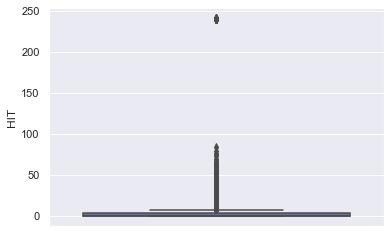

<Figure size 2160x1080 with 0 Axes>

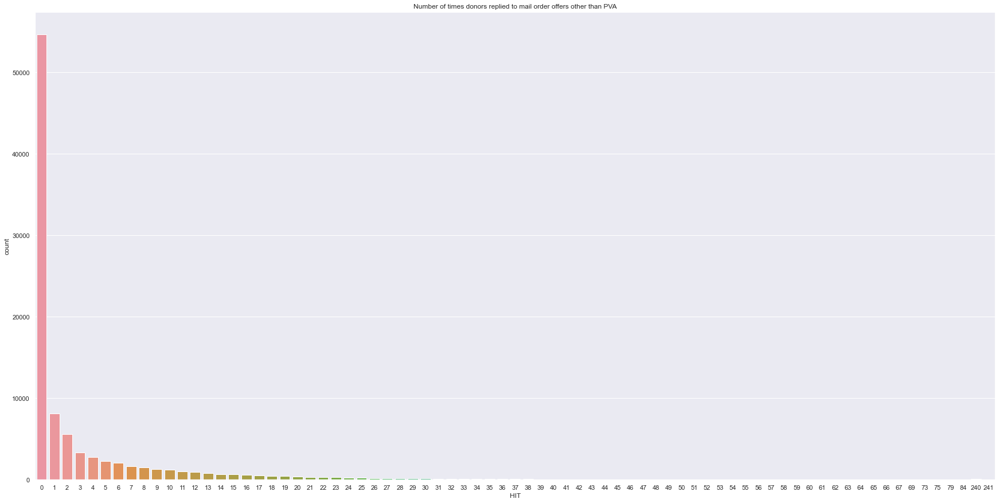

Percentage of data kept after removing outliers: 0.8563
Percentage of data kept after removing outliers: 0.9894
Percentage of data kept after removing outliers: 0.9992


In [295]:
# treat column HIT in order to analyse the presence of outliers

#create a boxplot for the variable HIT
sns.boxplot(y=donors["HIT"])
plt.figure(figsize=(30,15))

plt.show()

#create a histogram for the variable HIT
sns.set() 
plt.figure(figsize=(30,15))

sns.countplot(x=donors["HIT"])
plt.title("Number of times donors replied to mail order offers other than PVA")

plt.show() #The hits of 32 to 241 account for a very low number of donors

#assessment of outliers with interquartile range
q25 = donors[["HIT"]].quantile(.25)
q75 = donors[["HIT"]].quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

filters3 = []
for metric in donors[["HIT"]]:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters3.append(donors["HIT"].between(llim, ulim, inclusive=True))

filters3 = pd.Series(np.all(filters3, 0), index=donors.index)
my_project_f3 = donors[filters3]

#how much data is kept with interquartile range
print('Percentage of data kept after removing outliers:', np.round(my_project_f3.shape[0] / donors.shape[0], 4))

#detect outliers manually by limiting the number of replies to 31
filters1 = ((donors["HIT"]<=31))
my_project_noutliers = donors[filters1]

# how much data is kept if we limit the number of replies to 31
print('Percentage of data kept after removing outliers:', np.round(my_project_noutliers.shape[0] / donors.shape[0], 4))

#detect outliers manually by limiting the number of replies to 84
filters2 = ((donors["HIT"]<=84))
my_project_f2 = donors[filters2]

#how much data is kept if we limit the number of replies to 84
print('Percentage of data kept after removing outliers:', np.round(my_project_f2.shape[0] / donors.shape[0], 4))

# decide on keeping only the donors who reply until 31 times
donors= donors[filters1]


In [296]:
# treat the column SOLP3 so it is possible to integrate the information in the column RECP3 and then delete it, this will happen by distinguishing between donors that are not in P3 program and the ones who can receive always emails

#number of elements under column SOLP3 have a correspondent blank value under RECP3, meaning they represent donors who are not in P3 program.
donors[["RECP3","SOLP3"]].groupby(by=["RECP3"]).count()

#number of blank cells under SOLP3 which can account for missing values,donors who can be mailed as many times as we want or not member of P3 program. .
donors["SOLP3"].isin([" "]).sum(axis=0)

#index of the donors who don't belong to P3 program because they have a blank value under RECP3
grouped= donors[["RECP3","SOLP3"]].groupby(by=["RECP3"]).get_group(0).index

#transform the values under the column SOLP3  correspondent to the above axis in -1
solp31=donors.loc[grouped]["SOLP3"].replace(" ",-1)

#index of the donors who  belong to P3 program because they have a X under RECP3
grouped1=donors[["RECP3","SOLP3"]].groupby(by=["RECP3"]).get_group(1).index

#transform the donors under SOLP3 correspondent to the above axis and assume that they can be mailed as many times as we want to the number 12
solp32=donors.loc[grouped1]["SOLP3"].replace(" ",12)

#return the column SOLP3 with the necessary changes
donors["SOLP3"]=pd.concat([solp31,solp32])

#confirm the values under SOLP3
donors["SOLP3"].unique()

#transform the strings in integer
donors["SOLP3"].replace({"SOLP3": {"00":0,"12":12,"01": 1,"02":2}}, inplace=True)

#confirm the values under SOLP3
donors["SOLP3"].unique()

#drop the column RECP3
donors.drop(["RECP3"], axis=1,inplace=True)

In [297]:
#treat column SOLIH so it is possible to integrate the information in the column RECINHSE and then delete it, this will happen by distinguishing between donors that are not in IN House program and the ones who can receive always emails

#number of elements under column SOLIH have a correspondent blank value under RECINHSE, meaning they represent donors who are not inHouse program.
donors[["RECINHSE","SOLIH"]].groupby(by=["RECINHSE"]).count()

#index of the donors who don't belong to In House  program because they have a blank value under RECINHSE
SOLIHg_index1= donors.loc[donors['RECINHSE']==0].index.values

#transform the donors who don't belong to In House program under SOLIH in -1.
SOLIH1=donors.loc[SOLIHg_index1]["SOLIH"].replace(" ",-1)

#index of the donors who  belong to In House program because they have a X under RECINHSE
SOLIHg_index2=donors.loc[donors['RECINHSE']==1].index.values

#transform the donors under SOLIH" correspondent to the above axis and assume that they can be mailed as many times as we want to the number 12
SOLIH2=donors.loc[SOLIHg_index2]["SOLIH"].replace(" ",12)

#return the column SOLIH with the necessary changes
donors["SOLIH"]=pd.concat([SOLIH1,SOLIH2])

#confirm the values under SOLIH
donors["SOLIH"].unique()

#transform the strings in integer
donors.replace({"SOLIH": {"00":0,"12":12,"01":1,"02":2,"03":3,"04":4,"06":6}}, inplace=True)

#confirm the values under SOLIH
donors["SOLIH"].unique()

#drop the column RECINHSE
donors.drop(["RECINHSE"], axis=1,inplace=True)

In [298]:
#treat column MAJOR to see if the information matches the one in the column  MDMAUD, regarding no major donors, and if yes delete MAJOR

#check if all the donors with blank cells (not a major donor) under MAJOR correspond a donors with X value (meaning not a major donor) under  MDMAUD
donors.loc[donors["MAJOR"] ==" "][["MDMAUD"]] ["MDMAUD"].value_counts() #We can conclude that all blank values under column Major (that represent the not major donor) have a correspondent X in the column MDMAUD, so the column Major can be deleted 

#drop column MAJOR
donors.drop("MAJOR",axis=1, inplace=True)

In [299]:
###### BIAAAA

In [300]:
# Relation of WEALTH1 and INCOME
# First idea : As both variables tend to be very correlated we just wanted to keep one of them. 
# And looking at the amount of missing values, the idea is to pick the variable with less missing values (INCOME) and try to fill the possible values with the help of WEALTH1.
print('Percentage of missing values:')
print('WEALTH1 -', donors['WEALTH1'].isna().sum()/len(donors)*100)
print('INCOME -', donors['INCOME'].isna().sum()/len(donors)*100)

Percentage of missing values:
WEALTH1 - 47.19182058614832
INCOME - 22.36867568323048


In [301]:
# Try to understand the distribution of INCOME by each WEALTH1
donors.groupby(['WEALTH1'])['INCOME'].value_counts().unstack()

INCOME,1.0,2.0,3.0,4.0,5.0,6.0,7.0
WEALTH1,,,,,,,
0.0,853,612,254,271,220,66,63
1.0,869,1040,419,472,354,111,91
2.0,812,1157,547,634,552,151,113
3.0,689,1080,586,679,730,203,133
4.0,607,1107,701,878,941,264,186
5.0,579,984,680,1086,1171,394,235
6.0,494,941,783,1180,1312,603,341
7.0,408,761,695,1289,1550,692,600
8.0,318,528,581,1281,1816,1049,1000


In [302]:
# Defining a dictionary to associate the WEALTH1 with the most frequent INCOME
replace_income = donors.groupby(['WEALTH1'])['INCOME'].apply(lambda x: x.value_counts().index[0])
replace_income

WEALTH1
0.0    1.0
1.0    2.0
2.0    2.0
3.0    2.0
4.0    2.0
5.0    5.0
6.0    5.0
7.0    5.0
8.0    5.0
9.0    7.0
Name: INCOME, dtype: float64

In [303]:
# New series with the dictionary association
income_wealth1 = donors.WEALTH1.replace(replace_income)

In [304]:
income_wealth1

CONTROLN
95515     NaN
148535    7.0
15078     2.0
172556    2.0
47784     NaN
         ... 
184568    NaN
122706    7.0
189641    NaN
4693      NaN
185114    5.0
Name: WEALTH1, Length: 93014, dtype: float64

In [305]:
# Replacing the nans of INCOME with the WEALTH1 association 
donors.INCOME = np.where(pd.isnull(donors.INCOME), income_wealth1 , donors.INCOME)

In [306]:
# New percentage of missing values 
print('INCOME -', donors['INCOME'].isna().sum()/len(donors)*100)
# They stayed the same ??? 

INCOME - 22.36867568323048


In [307]:
# Check the missing values of WEALTH1 on INCOME nans
donors[donors['INCOME'].isna()]['WEALTH1']

CONTROLN
95515    NaN
47784    NaN
49909    NaN
12890    NaN
42556    NaN
          ..
78831    NaN
47945    NaN
156106   NaN
184568   NaN
189641   NaN
Name: WEALTH1, Length: 20806, dtype: float64

In [308]:
# All of the INCOME missing values are in common with WEALTH1 !!! We can't fill any value with this idea !
donors[donors['INCOME'].isna()]['WEALTH1'].isna().sum()/donors['INCOME'].isna().sum()

1.0

In [309]:
# What about WEALTH2?
donors[['WEALTH1','WEALTH2']].corr() # highly correlated

,WEALTH1,WEALTH2
WEALTH1,1.000000,0.869682
WEALTH2,0.869682,1.000000


In [310]:
print(donors['WEALTH1'].isna().sum(),donors['WEALTH2'].isna().sum()) # WEALTH1 more missing values

43895 42915


In [311]:
# Drop WEALTH1 since it has more missing values and its very correlated with WEALTH2 (treat the missing values after with knn imputation)
donors.drop('WEALTH1', axis=1, inplace=True)

In [312]:
# The following variables indicate the number of known times the donor has responded to other types of mail order offers. 
# Convert them into Y/N columns like the interests variables because anyways there are too many missing values in these HIT variables 
# (with this solution we will lose the degree of interest but its only for 50% of the data which is not a problem)

mail_offers = list(donors.filter(regex='^MB',axis=1).columns.values) + list(donors.filter(regex='^MAG',axis=1).columns.values)+ list(donors.filter(regex='^PUB',axis=1).columns.values)
donors[mail_offers]

,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,MAGFEM,MAGMALE,PUBGARDN,PUBCULIN,PUBHLTH,PUBDOITY,PUBNEWFN,PUBPHOTO,PUBOPP
CONTROLN,,,,,,,,,,,,,,
95515,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
148535,0.0,0.0,3.0,1.0,1.0,1.0,0.0,0.0,0.0,2.0,0.0,3.0,0.0,0.0
15078,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
172556,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
47784,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
122706,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
189641,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [313]:
for mail in mail_offers: donors[mail] = donors[mail].apply(lambda x: 1 if x>0 else 0) 

In [314]:
donors[mail_offers]

,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,MAGFEM,MAGMALE,PUBGARDN,PUBCULIN,PUBHLTH,PUBDOITY,PUBNEWFN,PUBPHOTO,PUBOPP
CONTROLN,,,,,,,,,,,,,,
95515,0,0,0,0,0,0,0,0,0,0,0,0,0,0
148535,0,0,1,1,1,1,0,0,0,1,0,1,0,0
15078,0,0,1,0,0,0,0,0,0,1,0,0,0,0
172556,0,0,0,0,0,0,0,0,0,0,0,0,0,1
47784,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184568,0,0,0,0,0,0,0,0,0,0,0,0,0,0
122706,0,0,1,0,0,0,0,0,0,0,0,0,0,0
189641,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [315]:
# Convert Y/' ' of the interests variables into 1/0
replaceBool_dict = {'Y': 1,' ': 0}
interests = ['COLLECT1', 'VETERANS', 'BIBLE', 'CATLG', 'HOMEE',
       'PETS', 'CDPLAY', 'STEREO', 'PCOWNERS', 'PHOTO', 'CRAFTS',
       'FISHER', 'GARDENIN', 'BOATS', 'WALKER', 'KIDSTUFF', 'CARDS',
       'PLATES']
for interest in interests: donors[interest].replace(replaceBool_dict, inplace = True)

In [316]:
# Treating redundant variables regarding the donor interests and the response to an email about that interest
##common_topics - crafts, gardening, collectables, photos, family stuff 
common_topics =[['MBCRAFT', 'CRAFTS'],['MBGARDEN','GARDENIN'],['PUBGARDN','GARDENIN'],['MBCOLECT','COLLECT1'],['MBCOLECT','PLATES'],['PUBPHOTO', 'PHOTO'],['MAGFAML','KIDSTUFF']]
common_topics

[['MBCRAFT', 'CRAFTS'],
 ['MBGARDEN', 'GARDENIN'],
 ['PUBGARDN', 'GARDENIN'],
 ['MBCOLECT', 'COLLECT1'],
 ['MBCOLECT', 'PLATES'],
 ['PUBPHOTO', 'PHOTO'],
 ['MAGFAML', 'KIDSTUFF']]

In [317]:
# if the donor responds to an email = he has interest
for topic in common_topics:
        donors[topic[1]] = np.where(donors[topic[0]]==1, 1, donors[topic[1]])

In [318]:
# drop columns
donors.drop(mail_offers, axis=1, inplace=True)

In [319]:
##### Treating dates from promotion and gifts history
# Analysis date 
present_date = dt.datetime.strptime('2020-09-01', '%Y-%m-%d')

In [320]:
# Function to calculate the interval of time between meaningful dates (in months, as TIMELAG)
def diff_month(d1,d2):
    return d1.dt.month - d2.dt.month + 12*(d1.dt.year - d2.dt.year)

In [321]:
# Interval between first gift and present date to understand how long the donors started to donate (this one in years)
donors['TENURE'] = 2020 - donors['FISTDATE'].str[:4].astype(float)
donors['TENURE'].value_counts()

5.0     13781
6.0     12520
7.0      9344
14.0     8700
9.0      8401
12.0     7899
10.0     7449
13.0     7329
8.0      7299
4.0      5126
11.0     5057
15.0       39
16.0       21
17.0       13
18.0        9
19.0        9
20.0        4
26.0        3
23.0        3
22.0        2
21.0        1
51.0        1
25.0        1
28.0        1
Name: TENURE, dtype: int64

In [322]:
# Using last gift date to calculate the inactivity of the donor (how long we dont receive donations)
donors['INACTIVITY'] = diff_month(pd.Series(present_date,index=donors.index),pd.to_datetime(donors['LASTDATE']))
donors['INACTIVITY'].value_counts()

57    19348
56    11685
55    10835
54    10222
58     8059
60     6289
59     5282
63     4321
65     4304
62     2896
61     2729
64     2364
43      798
45      740
44      724
66      484
46      419
47      395
48      271
52      211
49      198
53      166
51      139
50      135
Name: INACTIVITY, dtype: int64

In [323]:
# Trying to understand the effectiveness of last promotion, if the donor donate after the promotion or not
donors['PROMUSE'] = diff_month(pd.to_datetime(donors['LASTDATE']),pd.to_datetime(donors['MAXADATE']))

donors['PROMUSE'].value_counts()

-14    19283
-13    11657
-12    10853
-11    10248
-15     8052
-17     6295
-16     5270
-20     4330
-22     4287
-19     2876
-18     2737
-21     2354
 0       798
-2       743
-1       722
-23      481
-3       418
-4       395
-5       268
-9       249
-10      215
-6       199
-8       144
-7       136
 2         2
 1         2
Name: PROMUSE, dtype: int64

In [324]:
# drop FISTDATE since it's not as informative after the feature engineering of the tenure column
donors.drop(['FISTDATE','NEXTDATE','MAXADATE','MINRDATE','MAXRDATE','LASTDATE'], axis=1, inplace= True)

In [325]:
# fill missing values of Data Source of Overlay Data
donors['DATASRCE'].replace(' ', 0, inplace=True)
donors['DATASRCE'] = donors['DATASRCE'].astype(int)

In [326]:
donors.shape

(93014, 347)

In [327]:
donors.info(verbose=True,null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93014 entries, 95515 to 185114
Data columns (total 347 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   ODATEDW       93014 non-null  object 
 1   TCODE         93014 non-null  object 
 2   STATE         93014 non-null  object 
 3   ZIP           93014 non-null  int32  
 4   RECPGVG       93014 non-null  int64  
 5   RECSWEEP      93014 non-null  int64  
 6   MDMAUD        93014 non-null  object 
 7   DOMAIN        93014 non-null  object 
 8   CHILD03       93014 non-null  int64  
 9   CHILD07       93014 non-null  int64  
 10  CHILD12       93014 non-null  int64  
 11  CHILD18       93014 non-null  int64  
 12  INCOME        72208 non-null  float64
 13  GENDER        93014 non-null  object 
 14  HIT           93014 non-null  int64  
 15  DATASRCE      93014 non-null  int32  
 16  SOLP3         93014 non-null  object 
 17  SOLIH         93014 non-null  int64  
 18  WEALTH2       50099 

In [94]:
#REDUNDANCY

#check the variables that are highly correlated (more than or equal to 90%) and drop one of them to avoid redundancy

corr_matrix = donors.corr().abs()
high_corr_var=np.where(corr_matrix>=0.9)
high_corr_var=[(corr_matrix.columns[x],corr_matrix.columns[y]) for x,y in zip(*high_corr_var) if x!=y and x<y]
high_corr_var

[('POP901', 'POP902'),
 ('POP901', 'POP903'),
 ('POP902', 'POP903'),
 ('ETH2', 'ETHC4'),
 ('ETH2', 'ETHC5'),
 ('ETH5', 'ETH13'),
 ('ETH5', 'LSC2'),
 ('AGE901', 'AGE902'),
 ('AGE901', 'AGE904'),
 ('AGE902', 'AGE903'),
 ('AGE902', 'AGE904'),
 ('AGE902', 'AGE905'),
 ('AGE902', 'AGE906'),
 ('AGE903', 'AGE904'),
 ('AGE903', 'AGE905'),
 ('AGE903', 'AGE906'),
 ('AGE904', 'AGE905'),
 ('AGE904', 'AGE906'),
 ('AGE905', 'AGE906'),
 ('AGE907', 'HHD1'),
 ('AGEC6', 'HHAGE1'),
 ('AGEC7', 'MARR3'),
 ('HHAGE1', 'HHAGE3'),
 ('HHAGE1', 'HHAS1'),
 ('HHAGE3', 'HHAS1'),
 ('HHN1', 'HHD11'),
 ('HHN3', 'HHN4'),
 ('HHN3', 'HHP1'),
 ('HHN3', 'HHP2'),
 ('HHN3', 'HHD1'),
 ('HHN3', 'HHD4'),
 ('HHN3', 'RHP3'),
 ('HHN4', 'HHP1'),
 ('HHN4', 'HHP2'),
 ('HHN4', 'HHD1'),
 ('HHN4', 'RHP3'),
 ('HHN5', 'HHN6'),
 ('MARR1', 'HHD3'),
 ('HHP1', 'HHP2'),
 ('HHP1', 'HHD1'),
 ('HHP1', 'RHP3'),
 ('HHP2', 'RHP3'),
 ('DW1', 'DW2'),
 ('DW4', 'DW5'),
 ('DW4', 'DW6'),
 ('DW5', 'DW6'),
 ('DW5', 'HUPA2'),
 ('DW5', 'HUPA6'),
 ('DW6', 'HUPA

In [328]:
#REDUNDANCY

#90% correlation

#can drop POP902 (no of families) and POP903 (no of households) since redundant with POP901(no. of persons)
donors.drop(['POP902','POP903'], axis=1,inplace=True)

#can drop ETHC4(%black < Age 15) & ETHC5(%black 15 - 59) since redundant with ETH2(%black)...logically, age of the 
#people in the neighbourhood will not affect the willingness of the donor to donate making this info irrelevant
donors.drop(['ETHC4','ETHC5','ETHC6'], axis=1,inplace=True)

#can drop since the ages of the races are irrelevant and we already have the info on how many white people live in the 
#neighbourhood in ETH1
donors.drop(['ETHC1','ETHC2','ETHC3'], axis=1,inplace=True)

#can drop ETH13(%mexican) & LSC2 (%spanish speaking) since redundant with ETH5(%hispanic)...hispanic includes all 
#latinos (aka spanish speaking)
#drop all language variables due to lack of relevancy
donors.drop(['ETH13','ETH14','ETH15','ETH16','LSC1','LSC2','LSC3','LSC4'], axis=1,inplace=True)

#can drop these Ages because, AGEC variables are more informative and disaggregated...will keep summary variables 
#AGE904 (avg age of population) and AGE907 (%population under 18)
donors.drop(['AGE901','AGE902','AGE903','AGE905','AGE906'], axis=1,inplace=True)

#can drop this children ages because they are not as relevant since don't impact decision to donate...thus we will keep
#the CHIL variable instead since it is more aggregated
child_list=donors.filter(regex='^CHILC',axis=1).columns.values
donors.drop(child_list,axis=1,inplace=True)

#can drop HHD1(%Households w/ Related Children) since redundant with AGE907(%Population Under Age 18) 
donors.drop('HHD1', axis=1,inplace=True)

#can drop all MARR variables since once again it refers to neighbourhood not the donor himself, meaning that if my
#neighbour is widowed, this would not affect my decision to doate to veterans
donors.drop(['MARR1','MARR2','MARR3','MARR4'], axis=1,inplace=True)

#can drop HHAGE variables due to lack of relevancy since the ages of people in a household in a donor's neighbourhood
#won't impact his/her decision to donate
donors.drop(['HHAGE1','HHAGE2','HHAGE3'], axis=1,inplace=True)

#can drop HHD variables because describes who lives in each household while RHP (rooms), HHP (avg & median) & HHN describes number of people per household
#these variables refer to the neighbourhood meaning they have minimal influence on donors' decision to donate...
#so we can drop them due to lack of relevancy
HHD_list=donors.filter(regex='^HHD',axis=1).columns.values
HHN_list=donors.filter(regex='^HHN',axis=1).columns.values
donors.drop(np.concatenate([HHD_list,HHN_list]), axis=1,inplace=True)
donors.drop(['HHP1','HHP2'], axis=1,inplace=True)
donors.drop(['RHP1','RHP2','RHP3','RHP4'], axis=1,inplace=True)

#can drop HHAS variables which demonstrate a 'poor' neighbourhood which is also represented in IC6 (very low income)
donors.drop(['HHAS1','HHAS2','HHAS3','HHAS4'], axis=1,inplace=True)

#since DW variables refer to the style of house unit structures within neighbourhoods, this wouldn't influence donor behaviour
#thus drop them due to lack of relevancy
DW_list=donors.filter(regex='^DW',axis=1).columns.values
donors.drop(DW_list, axis=1,inplace=True)

#since HUPA refers to home style in neighbourhood,this wouldn't influence donor behaviour thus drop them due to lack of relevancy
HUPA_list=donors.filter(regex='^HUPA',axis=1).columns.values
donors.drop(HUPA_list, axis=1,inplace=True)

#can drop all HV variables since it represents average and median value which is a monetary value not a percentage. This
#is a problem because the census was created in 2010 which means the money will not have the same value today...HVP variables 
#are a better substitute
donors.drop(['HV1','HV2','HV3','HV4'], axis=1,inplace=True)

#can drop all RP variables because HVP variables tell us more about the donor
donors.drop(['RP1','RP2','RP3','RP4'], axis=1,inplace=True)

#can drop all HU variables except HU2 (correlated wuth HU1) because it can tell us the probability that the donor is a 
#renter or not(if he/she is a renter means they are mobile/unstable (lower family loading??) but also with more bills to pay)
#keep HU5 to know if the neighbourhood is only a holiday one so only occassionally inhabited
donors.drop(['HU1','HU3','HU4'], axis=1,inplace=True)

#can drop all IC variables except IC3, IC5 because average, household and per capita are more meaningful than median (especially
#when they have the same distributions) and families
donors.drop(['IC1','IC2','IC4'], axis=1,inplace=True)

#can drop IC15-IC23, since we will focus on households rather than families' income
IC_list = donors.filter(regex='^IC',axis=1).columns.values[11:]
donors.drop(IC_list, axis=1,inplace=True)

#can drop all TPE variables as they are irrelevant to the donors' decision to donate (the mode of transportation of 
#the neighbourhood can hint to its income which we already have in IC variables)
TPE_list = donors.filter(regex='^TPE',axis=1).columns.values
donors.drop(TPE_list, axis=1,inplace=True)

#can drop all LFC variables as the neighbours' employment status will not affect the donors' behaviour
LFC_list = donors.filter(regex='^LFC',axis=1).columns.values
donors.drop(np.delete(LFC_list,9), axis=1,inplace=True)

#can drop all OCC, EIC since the type of employment of the neighbours 10 years ago will not affect the donation decision
OCC_list = donors.filter(regex='^OCC',axis=1).columns.values
EIC_list = donors.filter(regex='^EIC',axis=1).columns.values
donors.drop(np.concatenate([OCC_list,EIC_list]), axis=1,inplace=True)

#we will keep SEC1 & SEC2 because there is a culturalt distinction between people attending public vs private schools
#which can affect their moral values leading to donation decision
#can drop the rest of SEC since it does not provide enough information
donors.drop(['SEC3','SEC4','SEC5'], axis=1,inplace=True)

#can drop all AFCs and VCs except AFC1 and AFC4 because a neighbourhood with veterans & active military can be more 
#prone to donating to PVA 
donors.drop(['AFC2','AFC3','AFC5','AFC6'], axis=1,inplace=True)

#can drop all VCs because which war the veterans particpated in in a donor's neighbourhood will not affect his/her 
#willingness to donate...too specific
donors.drop(['VC1','VC2','VC3','VC4'], axis=1,inplace=True)

#can drop all HC except HC15 (solar energy are environmentally friendly...aka culture of giving back)
HC_list = donors.filter(regex='^HC',axis=1).columns.values
donors.drop(np.delete(HC_list,14), axis=1,inplace=True)

#can drop CARDPROM since redundant with NUMPROM (and NUMPROM is more informative since it includes all types of promotions)
#we don't want to lose the information about the donors who did not receive a card promotions
donors.drop('CARDPROM', axis=1,inplace=True)

#can drop CARDGIFT since redundant with NGIFTALL (and NGIFTALL is more informative since it includes alltypes of promotions)
donors.drop('CARDGIFT', axis=1,inplace=True)

#can drop the CHIL variables since AGE907 sums them up
donors.drop(['CHIL1','CHIL2','CHIL3'], axis=1,inplace=True)

#can drop HUR1 and HUR2 because they are irrelevant (no of rooms per household per neighbourhood is too specific)
donors.drop(['HUR1','HUR2'], axis=1,inplace=True)

#can drop ADI code (Approved Driving Instructors code) because the type of driving rules followed per region in the 
#US would not affect donor behaviour
donors.drop('ADI', axis=1,inplace=True)

#can drop MC variables due to lack of relevancy especially because 2005 is too far back
donors.drop(['MC1','MC2','MC3'], axis=1,inplace=True)



In [229]:
#check to see that everything was dropped successfully
donors.shape

(93014, 154)

In [64]:
###Marta starts adding from here

In [329]:
#treat the column DOMAIN so as separate the information inside each cell in two columns.

#calculates the number of empty cells under the column DOMAIN
(donors["DOMAIN"]==" ").sum()

# calculates the mode of DOMAIN so as to fill in the missing values with it
mode=donors["DOMAIN"].mode().loc[0]

#replace the blank cells with the mode
donors.replace({"DOMAIN": {" ":mode}},inplace=True)

#verify if change was made
(donors["DOMAIN"]==" ").sum()

#split the infomation inside each cell under column DOMAIN into 2 colummns
urbanicity_level_neighbourhood = [] 
socio_econ_neighbourhood= [] 
 
for i in donors["DOMAIN"]: 
    urbanicity_level_neighbourhood.append(i[0]) 
    socio_econ_neighbourhood.append(int(i[1])) 

donors["urbanicity_level_neighbourhood"]=pd.DataFrame(urbanicity_level_neighbourhood)
donors["socio_econ_neighbourhood"]=pd.DataFrame(socio_econ_neighbourhood)

#confirm that the changes were made
donors["socio_econ_neighbourhood"].head()
donors["urbanicity_level_neighbourhood"].head()
donors.head()

#drop domain 
donors.drop("DOMAIN", axis=1, inplace=True)


In [330]:
#treat the variables MDMAUD_A,MDMAUD_R,MDMAUD_F so as to encode them and drop MDMAUD

#encoding of variable MDMAUD_A
df_ohc = donors.copy()      
from sklearn.preprocessing import OneHotEncoder 
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_MDMAUD_A_feat = ohc.fit_transform(df_ohc[["MDMAUD_A"]])
ohc_MDMAUD_A_names = ohc.get_feature_names(["MDMAUD_A"])
ohc_MDMAUD_A = pd.DataFrame(ohc_MDMAUD_A_feat, index=df_ohc.index, columns=ohc_MDMAUD_A_names)  
ohc_MDMAUD_A

#encoding of variable MDMAUD_F
df_ohc = donors.copy()      
from sklearn.preprocessing import OneHotEncoder 
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_MDMAUD_F_feat = ohc.fit_transform(df_ohc[["MDMAUD_F"]].values.tolist())
ohc_MDMAUD_F_names = ohc.get_feature_names(["MDMAUD_F"])
ohc_MDMAUD_F = pd.DataFrame(ohc_MDMAUD_F_feat, index=df_ohc.index, columns=ohc_MDMAUD_F_names)  
ohc_MDMAUD_F

#encoding of variable MDMAUD_R
df_ohc = donors.copy()      
from sklearn.preprocessing import OneHotEncoder 
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_MDMAUD_R_feat = ohc.fit_transform(df_ohc[["MDMAUD_R"]].values.tolist())
ohc_MDMAUD_R_names = ohc.get_feature_names(["MDMAUD_R"])
ohc_MDMAUD_R = pd.DataFrame(ohc_MDMAUD_R_feat, index=df_ohc.index, columns=ohc_MDMAUD_R_names)  
ohc_MDMAUD_R

#drop MDMAUD
donors.drop("MDMAUD", axis=1, inplace=True)

#drop MDMAUD_R,MDMAUD_F, MDMAUD_A and substitute by the encoded ones
donors = pd.concat([donors.drop(columns=["MDMAUD_R","MDMAUD_F","MDMAUD_A"]),ohc_MDMAUD_R, ohc_MDMAUD_F,ohc_MDMAUD_A], axis=1)

#verify changes 
donors.head()

,ODATEDW,TCODE,STATE,ZIP,RECPGVG,RECSWEEP,CHILD03,CHILD07,CHILD12,CHILD18,...,MDMAUD_R_I,MDMAUD_R_L,MDMAUD_R_X,MDMAUD_F_2,MDMAUD_F_5,MDMAUD_F_X,MDMAUD_A_L,MDMAUD_A_M,MDMAUD_A_T,MDMAUD_A_X
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,2009-01-01,0,IL,61081,0,0,0,0,0,0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
148535,2014-01-01,1,CA,91326,0,0,0,0,0,1,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
15078,2010-01-01,1,NC,27017,0,0,0,0,0,0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
172556,2007-01-01,0,CA,95953,0,0,0,0,0,0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
47784,2014-01-01,0,AL,35603,0,0,0,0,0,0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0


In [331]:
#drop the column ODATEDW as it gives information of the year when donor gave the first gift which corresponds to FISTDATE and we have created variable tenure to tell for how long the donors hare in PVA's database 
donors.drop(["ODATEDW"], axis=1, inplace=True)


In [68]:
donors.info(verbose=True,null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93014 entries, 95515 to 185114
Data columns (total 165 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   OSOURCE                         93014 non-null  object 
 1   TCODE                           93014 non-null  object 
 2   STATE                           93014 non-null  object 
 3   ZIP                             93014 non-null  int32  
 4   RECPGVG                         93014 non-null  int64  
 5   RECSWEEP                        93014 non-null  int64  
 6   CHILD03                         93014 non-null  int64  
 7   CHILD07                         93014 non-null  int64  
 8   CHILD12                         93014 non-null  int64  
 9   CHILD18                         93014 non-null  int64  
 10  INCOME                          72208 non-null  float64
 11  GENDER                          93014 non-null  object 
 12  HIT                       

In [233]:
non_metric_features = ['TCODE', 'STATE','ZIP','RECPGVG','RECSWEEP','CHILD03', 
                       'CHILD07', 'CHILD12', 'CHILD18', 'INCOME', 'GENDER',
                       'DATASRCE', 'SOLP3', 'SOLIH', 'WEALTH2', 'COLLECT1',
                       'VETERANS', 'BIBLE', 'CATLG', 'HOMEE', 'PETS', 'CDPLAY', 'STEREO',
                       'PCOWNERS', 'PHOTO', 'CRAFTS', 'FISHER', 'GARDENIN', 'BOATS',
                       'WALKER', 'KIDSTUFF', 'CARDS', 'PLATES','PEPSTRFL', 'MSA', 'DMA',
                       'RFA_2R', 'RFA_2F', 'RFA_2A','urbanicity_level_neighbourhood', 'socio_econ_neighbourhood',
                       'MDMAUD_R_D', 'MDMAUD_R_I', 'MDMAUD_R_L', 'MDMAUD_R_X',
                       'MDMAUD_F_2', 'MDMAUD_F_5', 'MDMAUD_F_X', 'MDMAUD_A_L',
                       'MDMAUD_A_M', 'MDMAUD_A_T', 'MDMAUD_A_X']

In [332]:
#create a list with the metric features
all_features = list(donors.columns.values)
for non_metric_feature in non_metric_features:
    all_features.remove(non_metric_feature)
metric_features = all_features
metric_features

['HIT',
 'POP901',
 'POP90C1',
 'POP90C2',
 'POP90C3',
 'POP90C4',
 'POP90C5',
 'ETH1',
 'ETH2',
 'ETH3',
 'ETH4',
 'ETH5',
 'ETH6',
 'ETH7',
 'ETH8',
 'ETH9',
 'ETH10',
 'ETH11',
 'ETH12',
 'AGE904',
 'AGE907',
 'AGEC1',
 'AGEC2',
 'AGEC3',
 'AGEC4',
 'AGEC5',
 'AGEC6',
 'AGEC7',
 'HU2',
 'HU5',
 'HVP1',
 'HVP2',
 'HVP3',
 'HVP4',
 'HVP5',
 'HVP6',
 'IC3',
 'IC5',
 'IC6',
 'IC7',
 'IC8',
 'IC9',
 'IC10',
 'IC11',
 'IC12',
 'IC13',
 'IC14',
 'PEC1',
 'PEC2',
 'LFC10',
 'OEDC1',
 'OEDC2',
 'OEDC3',
 'OEDC4',
 'OEDC5',
 'OEDC6',
 'OEDC7',
 'EC1',
 'EC2',
 'EC3',
 'EC4',
 'EC5',
 'EC6',
 'EC7',
 'EC8',
 'SEC1',
 'SEC2',
 'AFC1',
 'AFC4',
 'ANC1',
 'ANC2',
 'ANC3',
 'ANC4',
 'ANC5',
 'ANC6',
 'ANC7',
 'ANC8',
 'ANC9',
 'ANC10',
 'ANC11',
 'ANC12',
 'ANC13',
 'ANC14',
 'ANC15',
 'POBC1',
 'POBC2',
 'VOC1',
 'VOC2',
 'VOC3',
 'HC15',
 'MHUC1',
 'MHUC2',
 'AC1',
 'AC2',
 'NUMPROM',
 'CARDPM12',
 'NUMPRM12',
 'RAMNTALL',
 'NGIFTALL',
 'MINRAMNT',
 'MAXRAMNT',
 'LASTGIFT',
 'TIMELAG',
 'AVGGIFT

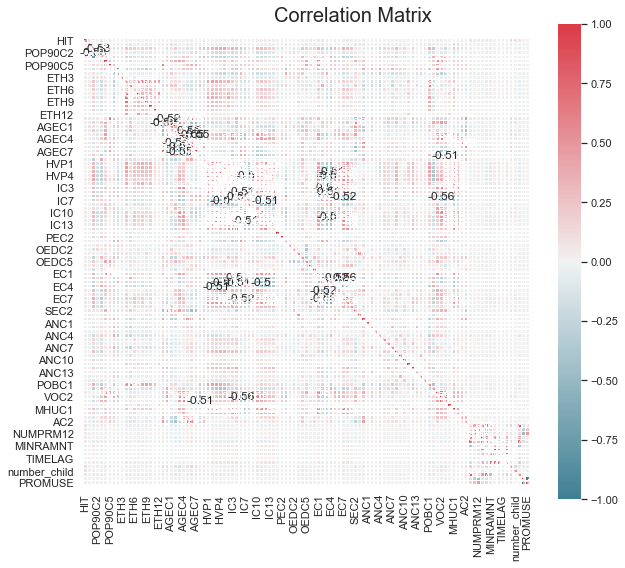

In [235]:
#CORRELATION HEATMAP

#Prepare figure
fig = plt.figure(figsize=(10, 8))

#Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(donors[metric_features].corr(method="pearson"), decimals=2)

#Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

#Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

#Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [73]:
donors.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93014 entries, 95515 to 185114
Columns: 165 entries, OSOURCE to MDMAUD_A_X
dtypes: float64(24), int32(1), int64(126), object(14)
memory usage: 119.9+ MB


In [333]:
#IT DOESNT WORK...AGAIN!!!
#outlier removal

q25 = donors.quantile(.25)
q75 = donors.quantile(.75)
iqr = (q75 - q25)

upper_lim = q75 + 5 * iqr
lower_lim = q25 - 5 * iqr

filters = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters.append(donors[metric].between(llim, ulim, inclusive=True))

filters = pd.Series(np.all(filters, 0), index=donors.index)
donors_2 = donors[filters]
print('Percentage of data kept after removing outliers:', np.round(donors_2.shape[0] / donors.shape[0], 4))

Percentage of data kept after removing outliers: 0.1174


In [334]:
# Creating new df copy to explore neighbordhood imputation
donors_neighbors = donors.copy()

# Seeing rows with NaNs
nans_index = donors_neighbors.isna().any(axis=1)
donors_neighbors[nans_index]

# KNNImputer - only works for numerical variables
imputer = KNNImputer(n_neighbors=4, weights="uniform")

# to fill the missing values of INCOME, WEALTH2 and DOMAIN (socio_econ_neighbourhood and urbanicity_level_neighbourhood)
related_variables = (['INCOME','WEALTH2','socio_econ_neighbourhood','urbanicity_level_neighbourhood', 'RFA_2A', 'AVGGIFT','MAXRAMNT','MINRAMNT'] +
                     list(donors.filter(regex='^HVP',axis=1).columns.values) +
                     list(donors.filter(regex='^IC',axis=1).columns.values) +
                     list(donors.filter(regex='^MDMAUD_A',axis=1).columns.values))

# Categories with strings - urbanicity_level_neighbourhood and RFA_2A
# Mapping to numeric so we can apply KNN
donors_neighbors['urbanicity_level_neighbourhood'].replace({"U":1, "C":2, "S":3, "T":4,"R": 5}, inplace= True)
donors_neighbors['RFA_2A'].replace({"D":1, "E":2, "F":3, "G":4}, inplace= True)

In [335]:
donors_neighbors[related_variables] = imputer.fit_transform(donors_neighbors[related_variables])

In [336]:
# See rows with NaNs imputed
donors_neighbors.loc[nans_index, related_variables]

,INCOME,WEALTH2,socio_econ_neighbourhood,urbanicity_level_neighbourhood,RFA_2A,AVGGIFT,MAXRAMNT,MINRAMNT,HVP1,HVP2,...,IC9,IC10,IC11,IC12,IC13,IC14,MDMAUD_A_L,MDMAUD_A_M,MDMAUD_A_T,MDMAUD_A_X
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,4.25,5.00,2.75,3.00,2.0,7.741935,12.0,5.0,2.0,7.0,...,23.0,15.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
148535,6.00,9.00,1.25,3.50,4.0,15.666667,25.0,10.0,97.0,98.0,...,5.0,15.0,14.0,13.0,10.0,33.0,0.0,0.0,0.0,1.0
172556,1.00,0.00,2.25,2.00,2.0,6.812500,11.0,2.0,10.0,25.0,...,26.0,22.0,5.0,0.0,0.0,4.0,0.0,0.0,0.0,1.0
47784,4.50,7.00,1.00,1.00,3.0,12.750000,16.0,10.0,3.0,9.0,...,22.0,21.0,5.0,2.0,1.0,1.0,0.0,0.0,0.0,1.0
109359,2.00,5.75,2.25,4.00,2.0,6.200000,11.0,5.0,1.0,6.0,...,17.0,26.0,3.0,7.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156106,3.25,3.00,1.50,3.75,4.0,26.666667,30.0,25.0,11.0,22.0,...,15.0,11.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
184568,5.50,7.25,1.50,3.75,4.0,25.000000,25.0,25.0,2.0,10.0,...,21.0,22.0,13.0,4.0,2.0,2.0,0.0,0.0,0.0,1.0
122706,7.00,7.75,2.00,3.00,3.0,20.000000,20.0,20.0,18.0,71.0,...,6.0,11.0,29.0,13.0,2.0,15.0,0.0,0.0,0.0,1.0


In [337]:
filled_variables= ['INCOME','WEALTH2','socio_econ_neighbourhood','urbanicity_level_neighbourhood']
for filled in filled_variables:
    donors_neighbors[filled] = donors_neighbors[filled].apply(lambda x: int(x+0.5))
    print(donors_neighbors[filled].unique())

[4 6 3 1 5 2 7]
[5 9 1 0 7 3 6 2 4 8]
[3 1 2 4]
[3 4 5 2 1]


In [338]:
# See rows with NaNs imputed
donors_neighbors.loc[nans_index, related_variables]

,INCOME,WEALTH2,socio_econ_neighbourhood,urbanicity_level_neighbourhood,RFA_2A,AVGGIFT,MAXRAMNT,MINRAMNT,HVP1,HVP2,...,IC9,IC10,IC11,IC12,IC13,IC14,MDMAUD_A_L,MDMAUD_A_M,MDMAUD_A_T,MDMAUD_A_X
CONTROLN,,,,,,,,,,,,,,,,,,,,,
95515,4,5,3,3,2.0,7.741935,12.0,5.0,2.0,7.0,...,23.0,15.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
148535,6,9,1,4,4.0,15.666667,25.0,10.0,97.0,98.0,...,5.0,15.0,14.0,13.0,10.0,33.0,0.0,0.0,0.0,1.0
172556,1,0,2,2,2.0,6.812500,11.0,2.0,10.0,25.0,...,26.0,22.0,5.0,0.0,0.0,4.0,0.0,0.0,0.0,1.0
47784,5,7,1,1,3.0,12.750000,16.0,10.0,3.0,9.0,...,22.0,21.0,5.0,2.0,1.0,1.0,0.0,0.0,0.0,1.0
109359,2,6,2,4,2.0,6.200000,11.0,5.0,1.0,6.0,...,17.0,26.0,3.0,7.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156106,3,3,2,4,4.0,26.666667,30.0,25.0,11.0,22.0,...,15.0,11.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
184568,6,7,2,4,4.0,25.000000,25.0,25.0,2.0,10.0,...,21.0,22.0,13.0,4.0,2.0,2.0,0.0,0.0,0.0,1.0
122706,7,8,2,3,3.0,20.000000,20.0,20.0,18.0,71.0,...,6.0,11.0,29.0,13.0,2.0,15.0,0.0,0.0,0.0,1.0


In [339]:
# let's keep the imputation
donors = donors_neighbors.copy()

In [341]:
# use OneHotEncoder to encode the categorical features as dummy variable encoding
ohc = OneHotEncoder(sparse=False, drop="first")
ohc_feat = ohc.fit_transform(donors[non_metric_encoding])
ohc_feat_names = ohc.get_feature_names()
ohc_donors = pd.DataFrame(ohc_feat, index=donors.index, columns=ohc_feat_names)  
ohc_donors

donors = pd.concat([donors.drop(columns=non_metric_encoding), ohc_donors], axis=1)

In [262]:
donors.info(verbose=True,null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93014 entries, 95515 to 185114
Data columns (total 233 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   TCODE                           93014 non-null  object 
 1   ZIP                             93014 non-null  int32  
 2   RECPGVG                         93014 non-null  int64  
 3   RECSWEEP                        93014 non-null  int64  
 4   CHILD03                         93014 non-null  int64  
 5   CHILD07                         93014 non-null  int64  
 6   CHILD12                         93014 non-null  int64  
 7   CHILD18                         93014 non-null  int64  
 8   HIT                             93014 non-null  int64  
 9   SOLP3                           93014 non-null  object 
 10  SOLIH                           93014 non-null  int64  
 11  COLLECT1                        93014 non-null  int64  
 12  VETERANS                  

In [248]:
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth
dbscan = DBSCAN(eps=1.9, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(donors[metric_features])



dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [ ]:
# Normalization
# Use MinMaxScaler to scale the data
scaler = MinMaxScaler()
scaled_feat = scaler.fit_transform(donors[metric_features])
scaled_feat

In [ ]:
# See what the fit method is doing (notice the trailing underscore):
print("Parameters fitted:\n", scaler.data_min_, "\n", scaler.data_max_)

In [ ]:
donors[metric_features] = scaled_feat
donors.head()

In [263]:
kmclust = KMeans(n_clusters=6, init='random', n_init=10, random_state=1)
# the fit method
kmclust.fit(metric_features)
kmclust.predict(metric_features)

ValueError: could not convert string to float: 'HIT'

In [66]:
pd.DataFrame(kmclust.transform(metric_features))

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,36949.176109,5233.473052,72919.405569,17376.824638,92357.978300,34773.051070,54796.409564,80655.130014,71062.235813,71564.442074,90457.582908,91616.948939,88103.738396,58869.664993,18717.251404
1,100498.795775,64879.575784,21951.061198,50821.717190,65693.095720,34886.730555,22464.355353,143268.933594,124781.303206,13655.985428,37806.185376,141127.051561,146821.227643,121795.503800,82971.117447
2,50920.835796,87127.457110,159985.252926,104191.670960,171255.510967,121885.652806,141680.978884,8355.058475,41162.538468,153216.515093,177768.917877,63109.733809,31453.216620,29820.821144,69162.409267
3,121613.734844,85413.989274,13675.619325,68317.204969,56509.616522,50817.490253,31531.173208,165314.301457,151049.822940,42556.992206,8455.091187,164166.681841,169664.234672,143268.371108,103297.674800
4,24285.367633,56164.785469,127660.017272,73015.189159,138851.957718,90242.370210,109689.122294,31493.551037,35155.755956,121353.133369,145173.400362,68252.407961,48466.258775,16519.521777,39671.522475
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94390,136547.058007,101183.828320,37143.830127,85007.568132,63697.093730,68413.706109,50874.143574,179512.141728,164877.438174,55607.285362,27845.384337,178124.143227,184006.707688,157737.150351,118764.548402
94391,69603.957926,33748.312189,41789.374881,20910.654300,73280.175956,12636.789220,25510.759351,112798.283137,96761.969730,37560.912287,60296.618426,114989.025854,117544.335022,91167.653006,51859.869113
94392,127489.022380,95681.858891,53845.351573,82902.021984,10021.696871,70731.687175,61867.545901,169489.178978,155936.637843,68871.074117,48272.249844,185539.172304,182275.149673,147119.598327,110881.645839
94393,74067.819703,95357.558670,155630.223160,107272.583309,187770.835961,121662.391209,137894.103298,64237.418971,71641.107089,148493.229166,174299.220136,7088.623934,35151.064968,68948.331792,83788.996505


For n_clusters = 2, the average silhouette_score is : 0.5757565113512921
For n_clusters = 3, the average silhouette_score is : 0.4916838615454121
For n_clusters = 4, the average silhouette_score is : 0.43439907153894447
For n_clusters = 5, the average silhouette_score is : 0.45874546817439693
For n_clusters = 6, the average silhouette_score is : 0.4722641683569894
For n_clusters = 7, the average silhouette_score is : 0.436814290602911
For n_clusters = 8, the average silhouette_score is : 0.4085457674996772
For n_clusters = 9, the average silhouette_score is : 0.38808533226884584
For n_clusters = 10, the average silhouette_score is : 0.3634673573940031
For n_clusters = 11, the average silhouette_score is : 0.3605898789058882
For n_clusters = 12, the average silhouette_score is : 0.3643830587629998
For n_clusters = 13, the average silhouette_score is : 0.3685340067566666
For n_clusters = 14, the average silhouette_score is : 0.34598916829931614


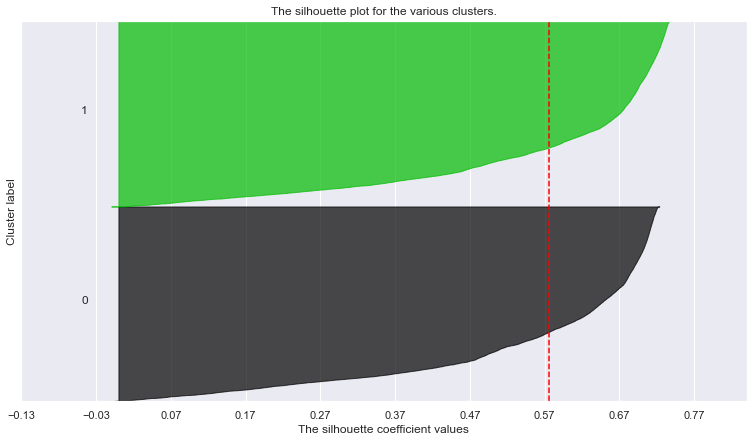

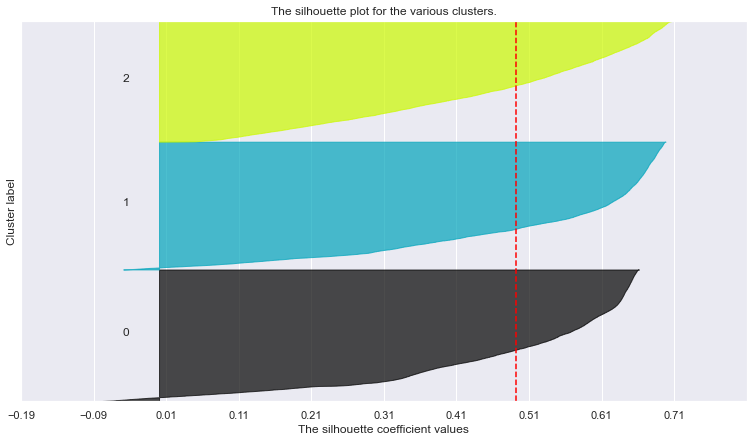

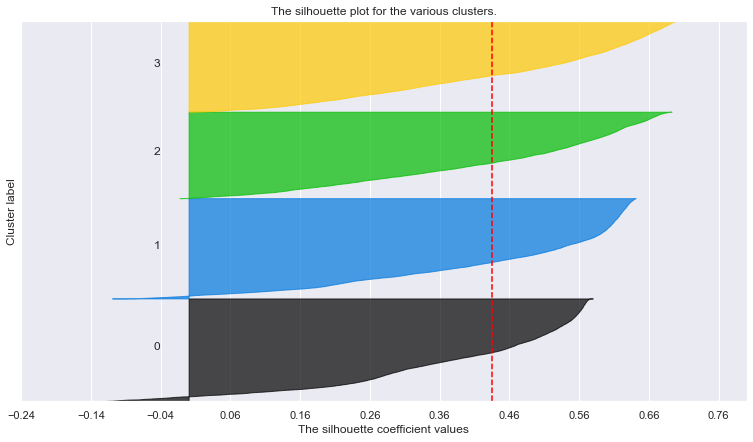

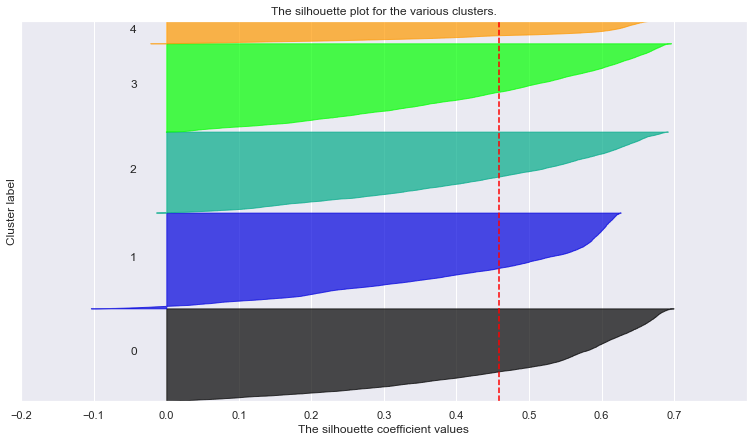

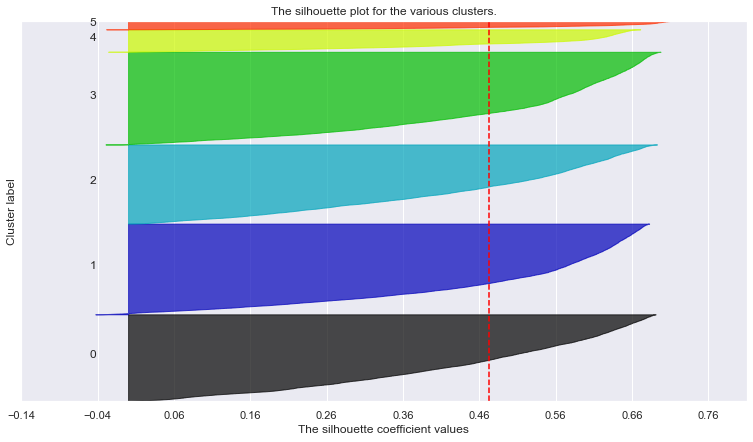

...

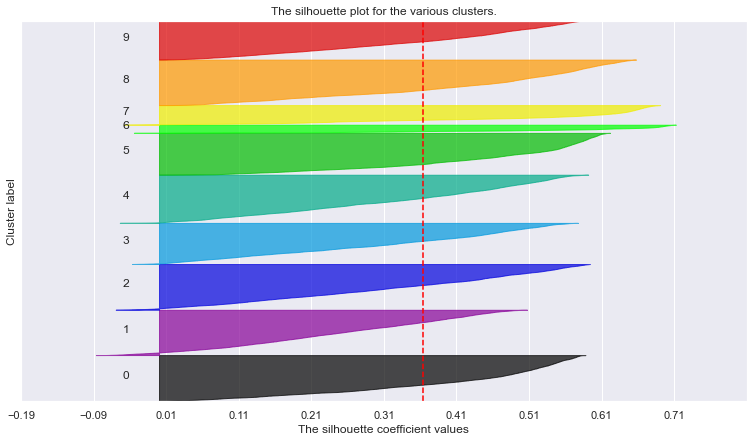

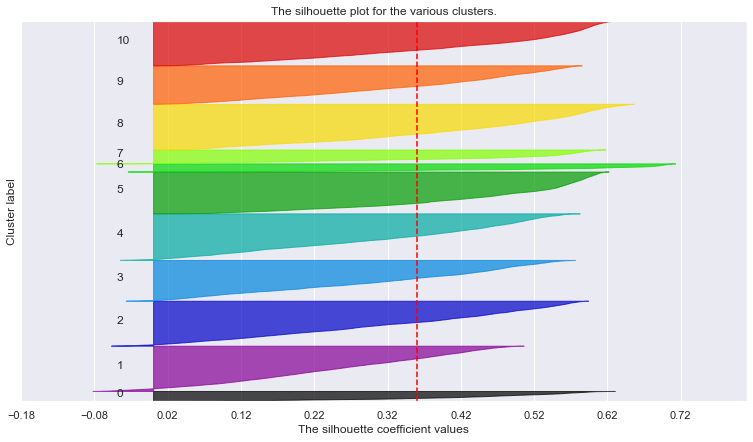

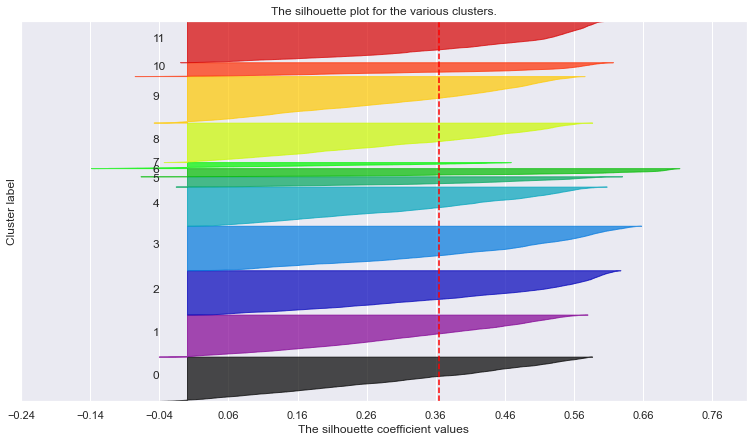

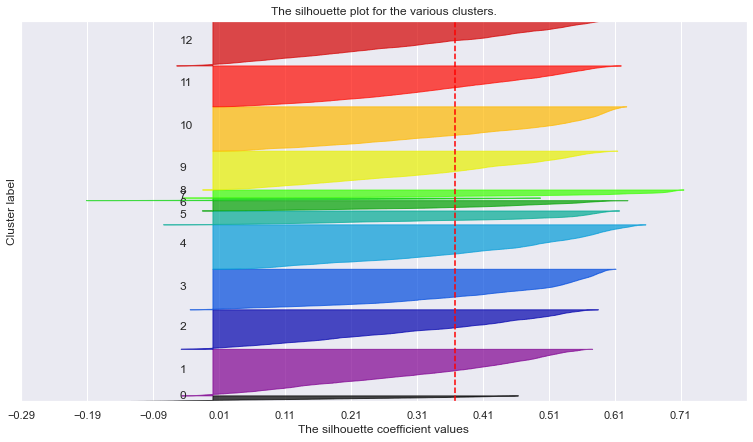

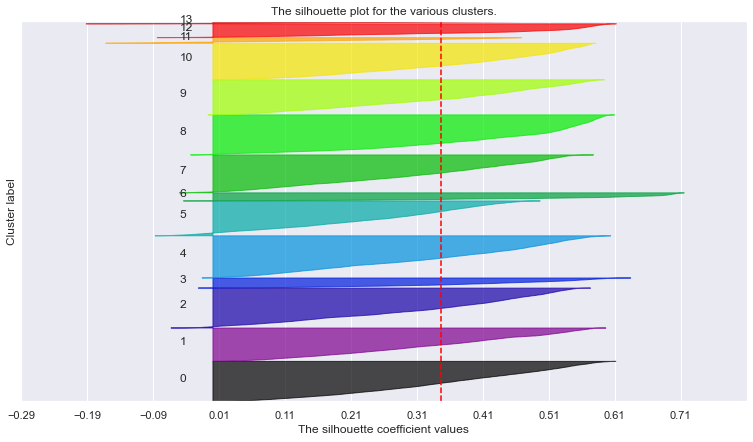

In [69]:
# Storing average silhouette metric
range_clusters = range(1, 15)
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(metric_features)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(metric_features, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(metric_features, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(metric_features) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

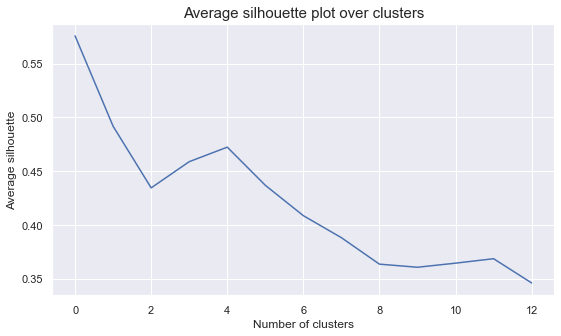

In [70]:
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(avg_silhouette)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()